# Проект. Фотохостинг "Со Смыслом"

Вы работаете в фотохостинге для профессиональных фотографов «Со Смыслом» (**With Sense**).
Ваши пользователи размещают свои фотографии на хостинге и сопровождают их полным описанием: указывают место съёмок, модель камеры и т. д. Отличительная особенность сервиса — описание: его может предоставить не только тот, кто размещает фотографию, но и другие пользователи портала. Например, для этой фотографии

Ваш отдел занимается экспериментом по разработке поиска референсных фотографий для фотографов. Суть поиска заключается в следующем: пользователь сервиса вводит описание нужной сцены. Сервис выводит несколько фотографий.

Чтобы эксперимент получил право на жизнь, нужно защитить его перед руководителем компании. Для защиты необходимо презентовать так называемый PoC (Proof of Concept, Проверка концепции) — продемонстрировать, что такой проект практически осуществим. Вам поручено разработать демонстрационную версию поиска изображений по запросу.
Для демонстрационной версии нужно выбрать лучшую  модель, которая получит векторное представление изображения, векторное представление текста, а на выходе выдаст число от 0 до 1 — и покажет, насколько текст и картинка подходят друг другу.
На основе лучшей модели можно будет собрать предварительную версию продукта, которую вы покажете руководителю компании.

В некоторых странах, где работает компания With Sense, действуют ограничения по обработке изображений: поисковым сервисам и сервисам, предоставляющим возможность поиска, запрещено без разрешения родителей или законных представителей предоставлять любую информацию, в том числе, но не исключительно, текстов, изображений, видео и аудио, содержащие описание, изображение или запись голоса детей. Ребёнком считается любой человек, не достигший 16-ти лет.
В вашем сервисе строго следуют законам стран, в которых работают. Поэтому при попытке посмотреть изображения, запрещённые законодательством, вместо картинок показывается дисклеймер: `This image is unavailable in your country in compliance with local laws.`
Однако у вас в PoC нет возможности воспользоваться данным функционалом. Поэтому необходимо очистить данные от проблемного контента. Во время тестирования модели при появлении в запросе “вредного” контента должен отображаться дисклеймер.

**Описание данных**

Ознакомиться с данными можно по [ссылке](https://code.s3.yandex.net/datasets/dsplus_integrated_project_4.zip)

В файле **train_dataset.csv** находится информация, необходимая для обучения: имя файла изображения, идентификатор описания и текст описания. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат *<имя файла изображения>#<порядковый номер описания>.*

В папке **train_images** содержатся изображения для тренировки модели.

В файле **CrowdAnnotations.tsv**  — данные по соответствию изображения и описания, полученные с помощью краудсорсинга. Номера колонок и соответствующий тип данных:
- Имя файла изображения.
- Идентификатор описания.
- Доля людей, подтвердивших, что описание соответствует изображению.
- Количество человек, подтвердивших, что описание соответствует изображению.
- Количество человек, подтвердивших, что описание не соответствует изображению.

В файле **ExpertAnnotations.tsv**  — данные по соответствию изображения и описания, полученные в результате опроса экспертов. Номера колонок и соответствующий тип данных:
- Имя файла изображения.
- Идентификатор описания.
- 3, 4, 5 — оценки трёх экспертов.

Эксперты ставят оценки по шкале от 1 до 4, где 1 — изображение и запрос совершенно не соответствуют друг другу, 2 — запрос содержит элементы описания изображения, но в целом запрос тексту не соответствует, 3 — запрос и текст соответствуют с точностью до некоторых деталей, 4 — запрос и текст соответствуют полностью.

В файле **test_queries.csv** находится информация, необходимая для тестирования: идентификатор запроса, текст запроса и релевантное изображение. Для одной картинки может быть доступно до 5 описаний. Идентификатор описания имеет формат *<имя файла изображения>#<порядковый номер описания>.*

В папке **test_images** содержатся изображения для тестирования модели

In [ ]:
!pip install -U sentence-transformers -q

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import os
from math import ceil
import nltk
from nltk.corpus import stopwords
from wordcloud import WordCloud


from PIL import Image
import tensorflow as tf
from keras.applications.resnet50 import preprocess_input
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet import ResNet50
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense
from tensorflow.keras.layers import Dense, BatchNormalization, Dropout
from tensorflow.keras.models import Sequential

import torch
from sentence_transformers import SentenceTransformer

from sklearn.preprocessing import Normalizer
from sklearn.model_selection import (GroupShuffleSplit, RandomizedSearchCV,
                                     ParameterGrid, GroupKFold)
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from lightgbm import LGBMRegressor

In [ ]:
RANDOM_STATE = 12345
PATH = '/content/drive/MyDrive/dsplus_integrated_project_4/to_upload/'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Исследовательский анализ данных

### Загрузка и обзор данных

**Тренировочный датафрейм train_dataset.csv**

In [ ]:
# Загрузим данные из файла
train_dataset = pd.read_csv(PATH + 'train_dataset.csv')

In [ ]:
# Посмотрим на данные
train_dataset.head()

,image,query_id,query_text
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...


In [ ]:
# Общая информация о датафрейме
train_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image       5822 non-null   object
 1   query_id    5822 non-null   object
 2   query_text  5822 non-null   object
dtypes: object(3)
memory usage: 136.6+ KB


In [ ]:
# Посмотрим на количество уникальных значений в каждой колонке датасета
for i in train_dataset.columns:
  print(train_dataset[i].nunique())

1000
977
977


In [ ]:
train_dataset.query('image =="757046028_ff5999f91b.jpg"')

,image,query_id,query_text
1011,757046028_ff5999f91b.jpg,3254817653_632e840423.jpg#2,A group of five adults stand posing in front o...
2843,757046028_ff5999f91b.jpg,3589367895_5d3729e3ea.jpg#2,An Indian chief in full dress .
3004,757046028_ff5999f91b.jpg,3145967309_b33abe4d84.jpg#2,A man in a white print shirt and a woman in a ...
5280,757046028_ff5999f91b.jpg,311146855_0b65fdb169.jpg#2,A man and a woman wearing decorative costumes ...
5643,757046028_ff5999f91b.jpg,506738508_327efdf9c3.jpg#2,Two men in white suits cheer
5817,757046028_ff5999f91b.jpg,2061144717_5b3a1864f0.jpg#2,A man in an ampitheater talking to a boy .


Согласно, подготовленному к данным описанию, одно изображение может иметь до 5 различных описаний. Изучив данные можно заметить, что некоторым изображениям соответствует больше 5 описаний. Это вопрос к датаинженеру.

In [ ]:
train_dataset.query('query_id =="2549968784_39bfbe44f9.jpg#2"')

,image,query_id,query_text
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
1,1262583859_653f1469a9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
2,2447284966_d6bbdb4b6e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
3,2549968784_39bfbe44f9.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
4,2621415349_ef1a7e73be.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
5,3030566410_393c36a6c5.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
6,3155451946_c0862c70cb.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
7,3222041930_f642f49d28.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
8,343218198_1ca90e0734.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...
9,3718964174_cb2dc1615e.jpg,2549968784_39bfbe44f9.jpg#2,A young child is wearing blue goggles and sitt...


Так же стоит отметить, что одно и то же текстовое описание может быть у различных изображений.

In [ ]:
# Посмотрим на количество полных дубликатов
train_dataset.duplicated().sum()

np.int64(0)

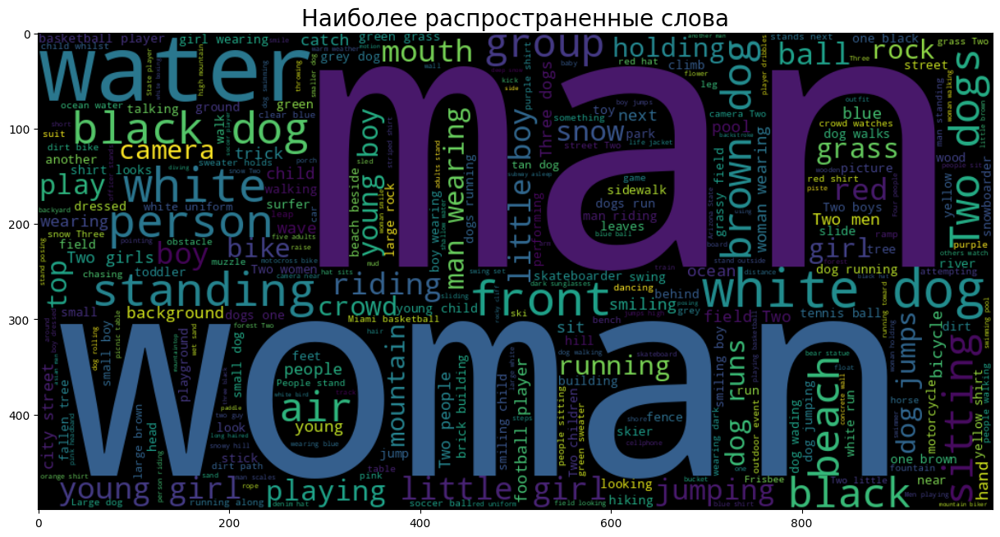

In [ ]:
plt.figure(figsize=(15,15))
text = ' '.join(train_dataset['query_text'].values)
WC = WordCloud(width=1000, height=500, max_words=500, min_font_size=5)
cloud = WC.generate(text)
plt.imshow(cloud, interpolation='bilinear')
plt.title('Наиболее распространенные слова', fontdict = {'fontsize' : 20})
plt.show()

**Вывод:**
* Датасет содержит 5822 строки с 977 уникальными описаниями к 1000 уникальных изображений.
* Одно изображение может иметь несколько описаний, но и конкретное описание может соответствовать нескольким изображениям.
* Данные не содержат пропусков и полных дубликатов
* Наиболее распространенные слова - мужчина, женщина, вода, собака

**CrowdAnnotations.tsv**

In [ ]:
#Загрузим данные из файла
crowd_annotations = pd.read_csv(PATH + 'CrowdAnnotations.tsv', sep='\t',
                                names=['image', 'query_id', 'part_of_confirm',
                                       'confirm', 'not_confirm'])

In [ ]:
# Посмотрим на данные
crowd_annotations.head()

,image,query_id,part_of_confirm,confirm,not_confirm
0,1056338697_4f7d7ce270.jpg,1056338697_4f7d7ce270.jpg#2,1.0,3,0
1,1056338697_4f7d7ce270.jpg,114051287_dd85625a04.jpg#2,0.0,0,3
2,1056338697_4f7d7ce270.jpg,1427391496_ea512cbe7f.jpg#2,0.0,0,3
3,1056338697_4f7d7ce270.jpg,2073964624_52da3a0fc4.jpg#2,0.0,0,3
4,1056338697_4f7d7ce270.jpg,2083434441_a93bc6306b.jpg#2,0.0,0,3


In [ ]:
# Общая информация о датафрейме
crowd_annotations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 47830 entries, 0 to 47829
Data columns (total 5 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   image            47830 non-null  object 
 1   query_id         47830 non-null  object 
 2   part_of_confirm  47830 non-null  float64
 3   confirm          47830 non-null  int64  
 4   not_confirm      47830 non-null  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 1.8+ MB


In [ ]:
print(crowd_annotations.image.nunique(), crowd_annotations.query_id.nunique())

1000 1000


In [ ]:
# Посмотрим на количество полных дубликатов
crowd_annotations.duplicated().sum()

np.int64(0)

In [ ]:
crowd_annotations.describe().T

,count,mean,std,min,25%,50%,75%,max
part_of_confirm,47830.0,0.068786,0.207532,0.0,0.0,0.0,0.0,1.0
confirm,47830.0,0.208488,0.628898,0.0,0.0,0.0,0.0,5.0
not_confirm,47830.0,2.820155,0.656676,0.0,3.0,3.0,3.0,6.0


Стоит обратить внимание, что в данных имеются такие изображения, с которыми работали более 3 человек на краудсорсинге

In [ ]:
# Доля данных, в которых в какой-либо степени подтверждено, что описание соответствует изображению
crowd_annotations.query('part_of_confirm > 0')['query_id'].count() \
 / len(crowd_annotations)

np.float64(0.12251724858875183)

In [ ]:
# Доля данных, в которых описание не соответствует изображению
crowd_annotations.query('part_of_confirm == 0')['query_id'].count() \
 / len(crowd_annotations)

np.float64(0.8774827514112482)

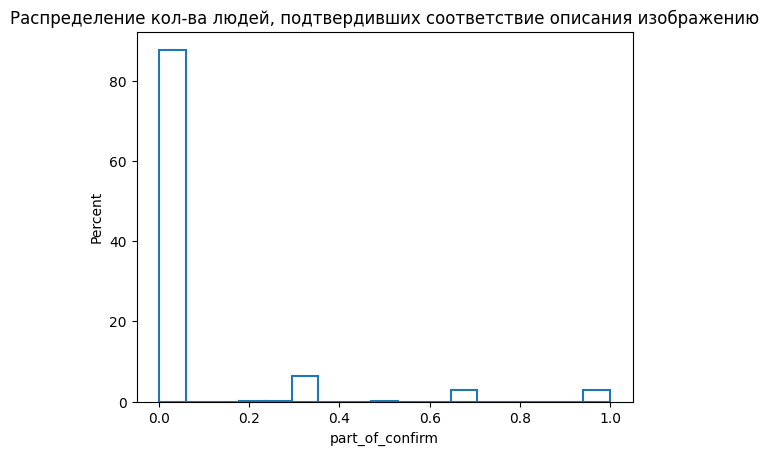

In [ ]:
sns.histplot(data=crowd_annotations['part_of_confirm'], stat='percent', fill=False)
plt.title(f'Распределение кол-ва людей, подтвердивших соответствие описания изображению');

Стоит обратить внимание на явный дисбаланс классов.

**Вывод:**
* Датафрейм содержит 47830 строк
* Некоторые изображения размечало больше 3 человек
* Данные не содержат пропусков и полных дубликатов

**ExpertAnnotations.tsv**

In [ ]:
# Загрузим данные из файла
expert_annotations = pd.read_csv(PATH + 'ExpertAnnotations.tsv', sep='\t',
                                 names=['image', 'query_id', 'expert_1',
                                        'expert_2', 'expert_3'])

In [ ]:
# Посмотрим на данные
expert_annotations.head(10)

,image,query_id,expert_1,expert_2,expert_3
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2
5,1056338697_4f7d7ce270.jpg,3360930596_1e75164ce6.jpg#2,1,1,1
6,1056338697_4f7d7ce270.jpg,3545652636_0746537307.jpg#2,1,1,1
7,1056338697_4f7d7ce270.jpg,434792818_56375e203f.jpg#2,1,1,2
8,106490881_5a2dd9b7bd.jpg,1425069308_488e5fcf9d.jpg#2,1,1,1
9,106490881_5a2dd9b7bd.jpg,1714316707_8bbaa2a2ba.jpg#2,2,2,2


In [ ]:
# Общая информация о датафрейме
expert_annotations.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   image     5822 non-null   object
 1   query_id  5822 non-null   object
 2   expert_1  5822 non-null   int64 
 3   expert_2  5822 non-null   int64 
 4   expert_3  5822 non-null   int64 
dtypes: int64(3), object(2)
memory usage: 227.6+ KB


In [ ]:
# Посмотрим на количество уникальных описаний и изображений
expert_annotations.image.nunique(), expert_annotations.query_id.nunique()

(1000, 977)

In [ ]:
expert_annotations.describe().T

,count,mean,std,min,25%,50%,75%,max
expert_1,5822.0,1.436620,0.787084,1.0,1.0,1.0,2.0,4.0
expert_2,5822.0,1.624356,0.856222,1.0,1.0,1.0,2.0,4.0
expert_3,5822.0,1.881999,0.904087,1.0,1.0,2.0,2.0,4.0


Если судить по среднему и медиане, то 3 эксперт чаще других видит большее соответвие текстового описания изображению

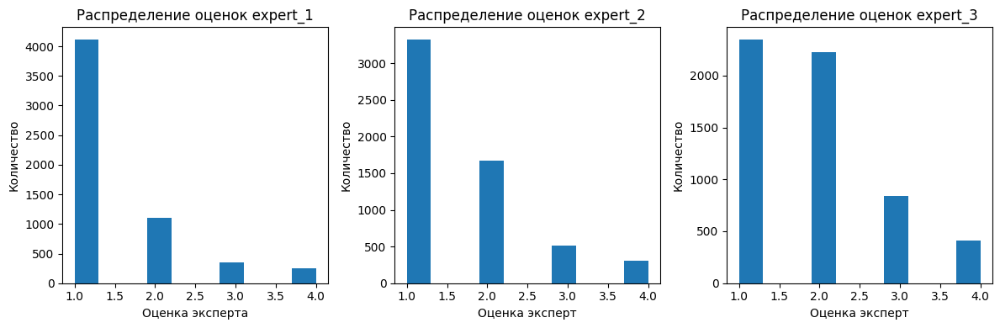

In [ ]:
plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.hist(expert_annotations['expert_1'])
plt.xlabel('Оценка эксперта')
plt.ylabel('Количество')
plt.title('Распределение оценок expert_1')

plt.subplot(1, 3, 2)
plt.hist(expert_annotations['expert_2'])
plt.xlabel('Оценка эксперт')
plt.ylabel('Количество')
plt.title('Распределение оценок expert_2')

plt.subplot(1, 3, 3)
plt.hist(expert_annotations['expert_3'])
plt.xlabel('Оценка эксперт')
plt.ylabel('Количество')
plt.title('Распределение оценок expert_3')

plt.tight_layout()
plt.show()

Это же подтверждается графиками.

In [ ]:
# Высчитаем среднюю экспертную оценку для каждого изображения
expert_annotations['mean_scores_experts'] = round(((expert_annotations['expert_1']
                                                   + expert_annotations['expert_2']
                                                   + expert_annotations['expert_3']) / 3), 2)

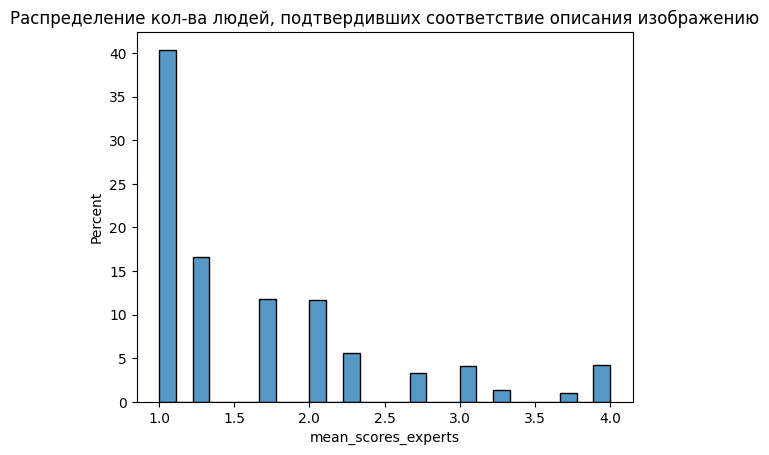

In [ ]:
sns.histplot(data=expert_annotations['mean_scores_experts'], stat='percent')
plt.title(f'Распределение кол-ва людей, подтвердивших соответствие описания изображению');

**Вывод:**
- Датафрейм содержит 5822 строк
- В большинестве случаем эксперты дают оценку - `изображение и запрос совершенно не соответствуют друг другу`
- Данные не содержат пропусков и полных дубликатов

**test_queries**

In [ ]:
# Загрузим данные из файла
test_queries = pd.read_csv(PATH + 'test_queries.csv', sep='|', index_col=0)

In [ ]:
# Посмотрим на данные
test_queries.head()

,query_id,query_text,image
0,1177994172_10d143cb8d.jpg#0,"Two blonde boys , one in a camouflage shirt an...",1177994172_10d143cb8d.jpg
1,1177994172_10d143cb8d.jpg#1,Two boys are squirting water guns at each other .,1177994172_10d143cb8d.jpg
2,1177994172_10d143cb8d.jpg#2,Two boys spraying each other with water,1177994172_10d143cb8d.jpg
3,1177994172_10d143cb8d.jpg#3,Two children wearing jeans squirt water at eac...,1177994172_10d143cb8d.jpg
4,1177994172_10d143cb8d.jpg#4,Two young boys are squirting water at each oth...,1177994172_10d143cb8d.jpg


In [ ]:
# Общая информация о датафрейме
test_queries.info()

<class 'pandas.core.frame.DataFrame'>
Index: 500 entries, 0 to 499
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   query_id    500 non-null    object
 1   query_text  500 non-null    object
 2   image       500 non-null    object
dtypes: object(3)
memory usage: 15.6+ KB


In [ ]:
# Посмотрим на количество уникальных значений в каждой колонке датасета
for i in test_queries.columns:
  print(test_queries[i].nunique())

500
500
100


In [ ]:
# Посмотрим на количество полных дубликатов
test_queries.duplicated().sum()

np.int64(0)

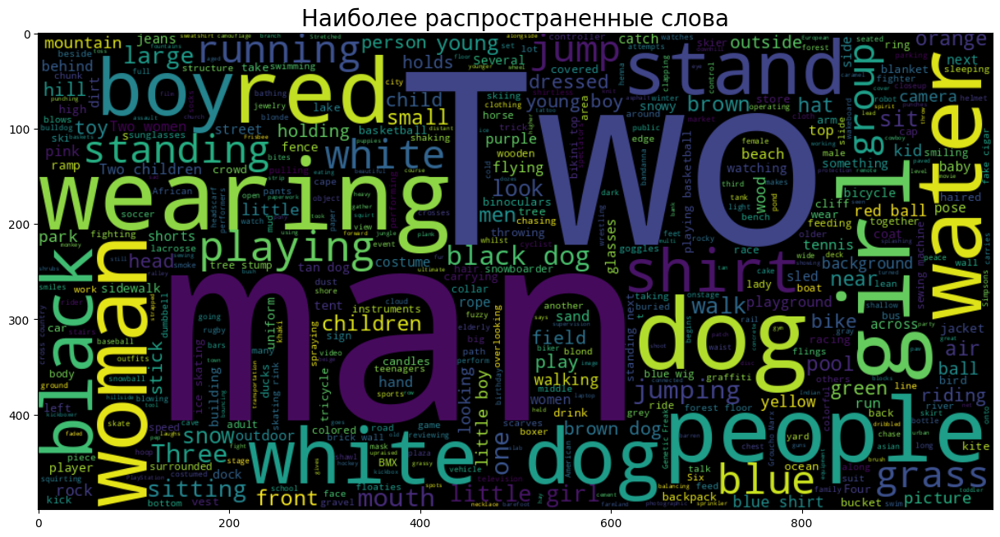

In [ ]:
plt.figure(figsize=(15,15))
text = ' '.join(test_queries['query_text'].values)
WC = WordCloud(width=1000, height=500, max_words=500, min_font_size=5)
cloud = WC.generate(text)
plt.imshow(cloud, interpolation='bilinear')
plt.title('Наиболее распространенные слова', fontdict = {'fontsize' : 20})
plt.show()

**Вывод:**
* Датасет содержит 500 строк с 500 уникальными описаниями к 100 уникальных изображений.
* Одно изображение может иметь несколько описаний
* Данные не содержат пропусков и полных дубликатов
* Наиболее распространенные слова - мужчина, женщина, вода, собака, девочка, мальчик, люди

**test_images**

In [ ]:
# Загрузим данные из файла
test_images = pd.read_csv(PATH + 'test_images.csv')

In [ ]:
# Посмотрим на данные
test_images.head()

,image
0,3356748019_2251399314.jpg
1,2887171449_f54a2b9f39.jpg
2,3089107423_81a24eaf18.jpg
3,1429546659_44cb09cbe2.jpg
4,1177994172_10d143cb8d.jpg


In [ ]:
# Общая информация о датафрейме
test_images.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   100 non-null    object
dtypes: object(1)
memory usage: 932.0+ bytes


In [ ]:
# Посмотрим на количество полных дубликатов
test_images.duplicated().sum()

np.int64(0)

**Вывод:**
* Датафрейм содержит 100 строк
* Данные не содержат пропусков и полных дубликатов

### Посмотрим на изображения из обучающего и тестового датасетов.

In [ ]:
# Сформируем случайные выборки из 15 изображений для датасетов
samples_train = train_dataset.sample(15)
samples_test = test_queries.sample(15)

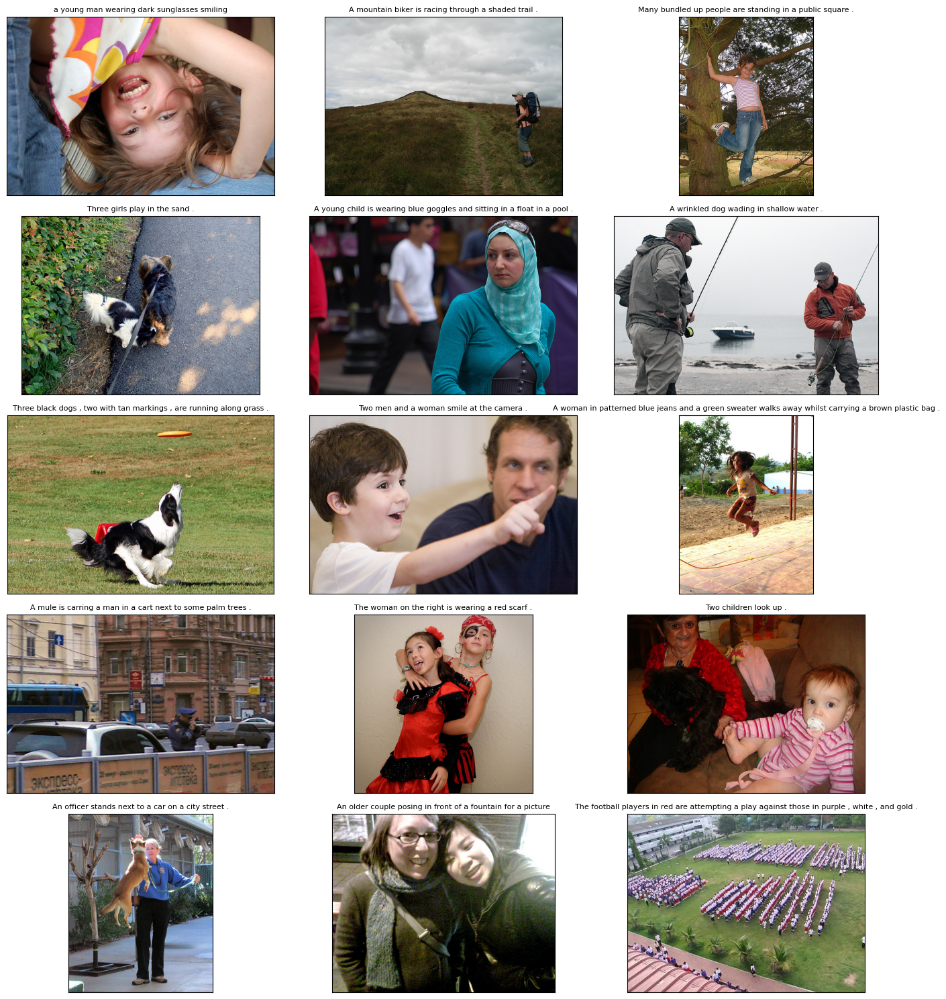

In [ ]:
# Посмотрим на 15 случайных изобажений с их описаниями из тренировочного набора
fig = plt.figure(figsize=(15,15))
for i in range(15):
    fig.add_subplot(5, 3, i+1)
    image = Image.open(PATH+'train_images/'+ samples_train.iloc[i, 0]) # добавляем изображения
    plt.title(samples_train.iloc[i, 2], fontsize=8) # добавляем описания
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([])
    plt.tight_layout();

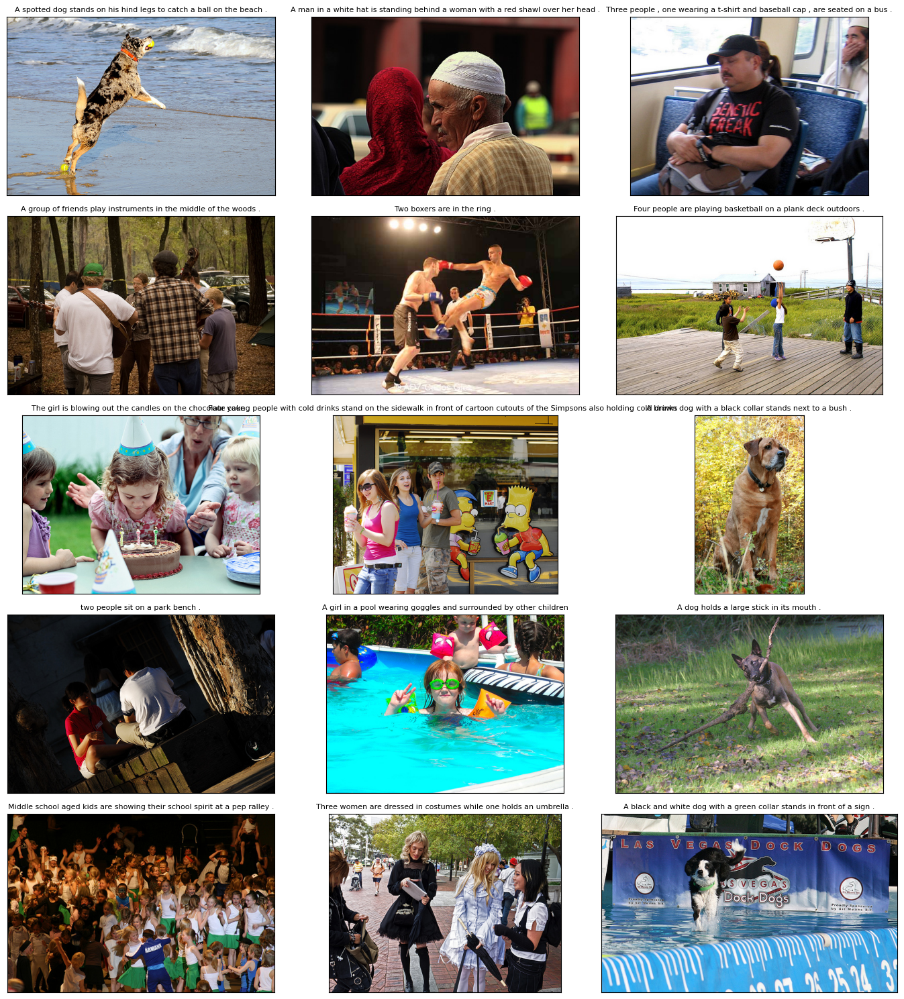

In [ ]:
# Посмотрим на 15 случайных изобажений с их описаниями из тестового набора
fig = plt.figure(figsize=(15,15))
for i in range(15):
    fig.add_subplot(5, 3, i+1)
    image = Image.open(PATH+'test_images/'+ samples_test.iloc[i, 2]) # добавляем изображения
    plt.title(samples_test.iloc[i, 1], fontsize=8) # добавляем описания
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([])
    plt.tight_layout();

**Вывод:**
* изображения имею разный размер
* в датасетах присутствуют изображения подпадающие под юридические ограничения
* если оценивать визуально, то в тренировочном датасете есть расхождения между текстовым описанием и изображением

### Агрегация оценок.

В предоставленных данных содержатся файлы по соответствию изображения и текстового описания, полученные с помощью краудсорсинга и размеченные экспертами.

В первом случае имеем большое количество данных, что является положительным моментом, низкое качество разметки и большой дисбаланс классов - негативная сторона.

Данные, полученные в результате опроса экспертов. К плюсам тут следует отнести высокое качество данных, к минусам - небольшой объем данных.

Следуя таким рассуждениям, кажется лучшим вариантом использовать только экспертные оценки. Проблему недостатка данных можно решить с помощью аугментации имеющихся изображений.

Способ определения агрегированной экспертной оценки установим как:
- метод большинства для случаев, где совпадают хотя бы 2/3 оценок
- усреднение, для случаев когда эксперты поставили разные оценки
- полученная оценка должна быть в диапозоне от 0 до 1

In [ ]:
# агрегируем и нормализуем оценки экспертов
def aggregate_score(df):

    # если оценки разные - усредняем
    if df['expert_1'] != df['expert_2'] != df['expert_3']:
        df['agg_score'] = (df['expert_1'] + df['expert_2'] + df['expert_3'] - 3) / 9

    # если есть одинаковые оценки - аггрегируем голосованием
    else:
        df['agg_score'] = (max(set([df['expert_1'], df['expert_2'], df['expert_3']]),
                                   key=[df['expert_1'], df['expert_2'], df['expert_3']].count) - 1) / 3

    return df

In [ ]:
expert_annotations = expert_annotations.apply(aggregate_score, axis=1)

In [ ]:
expert_annotations.head()

,image,query_id,expert_1,expert_2,expert_3,mean_scores_experts,agg_score
0,1056338697_4f7d7ce270.jpg,2549968784_39bfbe44f9.jpg#2,1,1,1,1.00,0.000000
1,1056338697_4f7d7ce270.jpg,2718495608_d8533e3ac5.jpg#2,1,1,2,1.33,0.000000
2,1056338697_4f7d7ce270.jpg,3181701312_70a379ab6e.jpg#2,1,1,2,1.33,0.000000
3,1056338697_4f7d7ce270.jpg,3207358897_bfa61fa3c6.jpg#2,1,2,2,1.67,0.333333
4,1056338697_4f7d7ce270.jpg,3286822339_5535af6b93.jpg#2,1,1,2,1.33,0.000000


In [ ]:
# Проверим данные на пропуски
expert_annotations.isna().sum()

,0
image,0
query_id,0
expert_1,0
expert_2,0
expert_3,0
mean_scores_experts,0
agg_score,0


In [ ]:
# Посмотрим на распределение получившихся оценок
expert_annotations.agg_score.value_counts(normalize=True)

,proportion
agg_score,
0.000000,0.571453
0.333333,0.285812
0.666667,0.088973
1.000000,0.053418
0.444444,0.000344


В более чем половине всех случаев описание не соответствует изображению

### Объединим обучающий датасет и датасет с агрегированными оценками

In [ ]:
data = pd.merge(train_dataset, expert_annotations,
                how='outer', on=['image', 'query_id'])

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5822 entries, 0 to 5821
Data columns (total 8 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   image                5822 non-null   object 
 1   query_id             5822 non-null   object 
 2   query_text           5822 non-null   object 
 3   expert_1             5822 non-null   int64  
 4   expert_2             5822 non-null   int64  
 5   expert_3             5822 non-null   int64  
 6   mean_scores_experts  5822 non-null   float64
 7   agg_score            5822 non-null   float64
dtypes: float64(2), int64(3), object(3)
memory usage: 364.0+ KB


In [ ]:
# Проверим данные на дубликаты
data.duplicated().sum()

np.int64(0)

In [ ]:
# Удалим колонки, которые нам в дальнейшем не понадобятся
data = data[['image', 'query_id', 'query_text', 'agg_score']]

In [ ]:
# Посмотрим на получившийся датафрейм
data.sample(5)

,image,query_id,query_text,agg_score
876,2183227136_8bb657846b.jpg,2183227136_8bb657846b.jpg#2,A person on the beach beside the ocean at suns...,1.000000
52,1131800850_89c7ffd477.jpg,3549583146_3e8bb2f7e9.jpg#2,A young boy is riding a bike .,0.000000
5032,3741462565_cc35966b7a.jpg,700884207_d3ec546494.jpg#2,A woman holds a fat baby with sunglasses and a...,0.000000
845,2160266952_a2ab39191b.jpg,2842865689_e37256d9ce.jpg#2,The person in the yellow shirt is sitting with...,0.333333
2344,2866254827_9a8f592017.jpg,3485425825_c2f3446e73.jpg#2,A young girl is standing on the back of a man ...,0.000000


In [ ]:
for i in data.columns:
  print(data[i].nunique())

1000
977
977
5


**Вывод по разделу:**
- Провели исследовательский анализ предоставленных данных
- Определили и обосновали предпочтительность экспертных оценок в дальнейшей работе
- Провели агрегацию экспертных оценок
- Объединили оценки с обучающим датасетом
- В итоговых данны имеем 5822 строк с 1000 уникальных изображений и 977 уникальных текстовых описания
- В оценках существует перекос в сторону `несоответствия описания изображению (класс 0)`  

## Проверка данных на юридические ограничения

В некоторых странах, где работает ваша компания, действуют ограничения по обработке изображений: поисковым сервисам и сервисам, предоставляющим возможность поиска, запрещено без разрешения родителей или законных представителей предоставлять любую информацию, в том числе, но не исключительно тексты, изображения, видео и аудио, содержащие описание, изображение или запись голоса детей. Ребёнком считается любой человек, не достигший 16 лет.

Для начала разметим наши данные на те строки, что содержат слова описывающие контент попадающий под юридические ограничения`(1)` и те, которые такой контент не содержат`(0)`.

In [ ]:
# Определим слова, описывающие детей и подростков
STOP_WORDS = ['girl', 'girls', 'boy', 'boys', 'kid', 'kids', 'baby', 'babies',
              'child', 'children', 'teen', 'teenager', 'teenagers', 'young',
              'infant']

In [ ]:
# Добавим колонку с меткой, указывающую на наличие "стоп-слов" в текстовых описаниях
def stop_words(df):
    for word in STOP_WORDS:
        if word in df['query_text']:
            return 1
    return 0

In [ ]:
data['block_tag'] = data.apply(stop_words, axis=1)
data.sample(10)

,image,query_id,query_text,agg_score,block_tag
2867,3053743109_a2d780c0d2.jpg,2575647360_f5de38c751.jpg#2,People gathered in an artist 's studio .,0.333333,0
4365,3504881781_6a842e043b.jpg,754852108_72f80d421f.jpg#2,Man in denim hat wearing dark sunglasses .,0.000000,0
5293,470373679_98dceb19e7.jpg,3396157719_6807d52a81.jpg#2,A dog gets on a trampoline .,0.000000,0
4588,3569406219_f37ebf7b92.jpg,3027397797_4f1d305ced.jpg#2,A skateboarder in striped shorts skating down ...,0.333333,0
4622,3578914491_36019ba703.jpg,1446053356_a924b4893f.jpg#2,Two girls in soccer strips are playing on a sp...,0.000000,1
1047,2247889670_413db8094b.jpg,3630641436_8f9ac5b9b2.jpg#2,Three dogs rush to chase a ball thrown into th...,0.333333,0
1135,2300168895_a9b83e16fc.jpg,229862312_1a0ba19dab.jpg#2,A dog rolling in the grass .,0.666667,0
3526,3245070961_8977fdd548.jpg,2288099178_41091aa00c.jpg#2,Two boys on ice skates race on an outdoor ice ...,0.000000,1
4557,3564543247_05cdbc31cf.jpg,2461616306_3ee7ac1b4b.jpg#2,a boy jumps into the blue pool water .,0.666667,1
5696,757332692_6866ae545c.jpg,3004823335_9b82cbd8a7.jpg#2,"A dog in a grassy field , looking up .",0.000000,0


In [ ]:
data.block_tag.value_counts()

,count
block_tag,
0,4263
1,1559


Более чем в 1500 строк с текстовым описанием содержатся "стоп-слова"

Исходя из описания данных, можно понять что `query_id` состоит из `<имя файла изображения>#<порядковый номер описания>`, поэтому удалив последние 2 знака  идентификатора описания, мы получим имена файлов изображений, содержащие контент попадающий под юридические ограничения. Которые впоследствии удалим.

In [ ]:
# Получим список изображений
block_images = data.query('block_tag == 1')['query_id'].apply(lambda x:x[:-2])

In [ ]:
# Кол-во уникальных изображений подпадающих под ограничения
block_images.nunique()

289

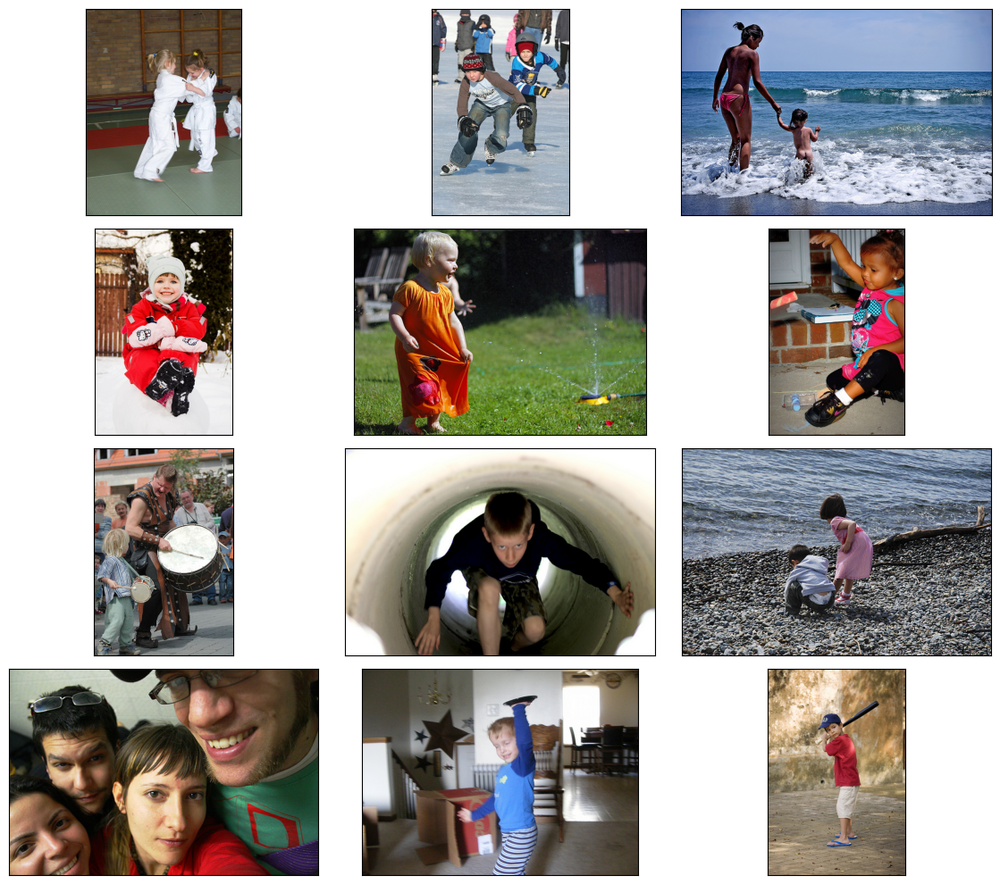

In [ ]:
# Выведем несколько изображений подпадающих под юридические ограничения
sample_block = data.query('image in @block_images').sample(12)

fig = plt.figure(figsize=(12,10))
for i in range(12):
    fig.add_subplot(4, 3, i+1)
    image = Image.open(PATH+'train_images/'+ sample_block.iloc[i, 0])
    plt.imshow(image)
    plt.xticks([])
    plt.yticks([])
    plt.tight_layout();

На изображениях можно увидеть детей

In [ ]:
# Удалим из датасета изображения подпадающие под ограничения
data = data.query('image not in @block_images')

In [ ]:
# Сбрасываем индексы
data.reset_index(inplace=True)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4103 entries, 0 to 4102
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   index       4103 non-null   int64  
 1   image       4103 non-null   object 
 2   query_id    4103 non-null   object 
 3   query_text  4103 non-null   object 
 4   agg_score   4103 non-null   float64
 5   block_tag   4103 non-null   int64  
dtypes: float64(1), int64(2), object(3)
memory usage: 192.5+ KB


**Вывод:**
- определили слова по которым, впоследствии нашли контент нарушающий законодательства
- удалили изображения подпадающие под юридические ограничения

## Векторизация изображений

In [ ]:
# Генератор данных для обучения модели
datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

def load_train():
    train_generator = datagen.flow_from_dataframe(
        dataframe = data,
        directory=PATH+'train_images/',
        x_col = 'image',
        y_col = 'agg_score',
        target_size=(224, 224),
        class_mode='input',
        seed=RANDOM_STATE,
        shuffle=False)

    return train_generator

In [ ]:
# Сверточная нейронная сеть предобученная на датасете Imagenet с отключенным слоем отвечающим за предсказания
def create_model(input_shape=(224, 224, 3)):
    backbone = ResNet50(input_shape=(224, 224, 3),
                    weights='imagenet',
                    include_top=False)
    model = Sequential()
    model.add(backbone)
    model.add(GlobalAveragePooling2D()) # слой усредняющий ширину и высоту изображений
    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='mean_squared_error',
                  metrics=['mae'])
    return model

In [ ]:
def vectorize_pictures(model, data):
    """
    Выполняет векторизацию изображений с использованием заданной модели.

    Возвращает: np.ndarray: Векторизованные представления изображений.
    """
    predictions = model.predict(data)
    return predictions

In [ ]:
# Выполним векторизацию изображений с использованием созданной модели и генератора данных
image_features = vectorize_pictures(create_model(), load_train())

# Выведем размерность полученных векторизованных представлений
image_features.shape

Found 4103 validated image filenames.


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


129/129 ━━━━━━━━━━━━━━━━━━━━ 763s 6s/step


(4103, 2048)

In [ ]:
# Масшабируем полученные вектора
scaler_image = Normalizer(norm='l2')
image_features_norm = scaler_image.fit_transform(image_features)
image_features_norm.shape

(4103, 2048)

**Вывод:**
Получили эмбеддинги изображений с помощью предобученной модели ResNet50

## Векторизация текстов

In [ ]:
model_st = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


In [ ]:
model_st = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

def vectorize_text(texts):
    embeddings = model_st.encode(
        texts,
        show_progress_bar=True,
        convert_to_numpy=True
    )
    return embeddings

In [ ]:
features_text = vectorize_text(data['query_text'])
features_text.shape

Batches:   0%|          | 0/129 [00:00<?, ?it/s]

(4103, 384)

In [ ]:
# Масшабируем полученные вектора
scaler_text = Normalizer(norm='l2')
features_text_norm = scaler_text.fit_transform(features_text)
features_text_norm.shape

(4103, 384)

**Вывод:** Получили эмбеддинги текстов при помощи предобученной модели *all-MiniLM-L6-v2*

## Объединение векторов

In [ ]:
features = np.concatenate((image_features_norm, features_text_norm), axis=1)
features.shape

(4103, 2432)

## Обучение моделей

In [ ]:
# Получим целевую переменную
target = np.array(data['agg_score'])
target.shape

(4103,)

In [ ]:
# Разделим датасет на тренировочную и тестовую выборки
gss = GroupShuffleSplit(n_splits=1, train_size=.7, random_state=RANDOM_STATE)
train_indices, test_indices = next(gss.split(X=features, y=target, groups=data['image']))

X_train, X_valid = features[train_indices], features[test_indices]
y_train, y_valid = target[train_indices], target[test_indices]

print(X_train.shape, X_valid.shape, y_train.shape, y_valid.shape)

(2866, 2432) (1237, 2432) (2866,) (1237,)


**LinearRegression**

Поскольку перед нами стоит задача показать близость двух векторов - конкатенированный вектор изображения и текстового описания на входе, а на выходе агрегированная оценка. Это является задачей регрессии. Выбираем метрику среднеквадратичной ошибки (MSE), по которой и будем измерять точность моделей.

In [ ]:
lr = LinearRegression()
lr.fit(X_train, y_train)
mse_lr = mean_squared_error(y_valid, lr.predict(X_valid))

In [ ]:
results = pd.DataFrame(columns=['model', 'mse'])
results.loc[len(results)] = ['LinearRegression', mse_lr]
results

,model,mse
0,LinearRegression,0.101654


**RandomForestRegressor**

In [ ]:
trees = RandomForestRegressor(random_state=RANDOM_STATE)

In [ ]:
param_grid_trees = {
    'max_depth': [2, 4, 6],
    'max_features': [2, 4, 8],
    'min_samples_leaf': [2, 6, 10]
}

In [ ]:
groups_train = data['query_id'][train_indices].values

In [ ]:
rs_trees = RandomizedSearchCV(
    trees,
    param_grid_trees,
    n_jobs=-1,
    cv=GroupKFold(),
    scoring='neg_mean_squared_error',
    random_state=RANDOM_STATE
)

In [ ]:
%%time
rs_trees.fit(X_train, y_train, groups=groups_train)

CPU times: user 805 ms, sys: 54.4 ms, total: 860 ms
Wall time: 21.9 s


RandomizedSearchCV(cv=GroupKFold(n_splits=5, random_state=None, shuffle=False),
                   estimator=RandomForestRegressor(random_state=12345),
                   n_jobs=-1,
                   param_distributions={'max_depth': [2, 4, 6],
                                        'max_features': [2, 4, 8],
                                        'min_samples_leaf': [2, 6, 10]},
                   random_state=12345, scoring='neg_mean_squared_error')

In [ ]:
mse_trees = mean_squared_error(y_valid, rs_trees.predict(X_valid))

In [ ]:
results.loc[len(results)] = ['RandomForestRegressor', mse_trees]
results

,model,mse
0,LinearRegression,0.101654
1,RandomForestRegressor,0.076291


**LGBMRegressor**

In [ ]:
lightgbm = LGBMRegressor(
    boosting_type='gbdt',
    objective='regression',
    metric='mse',
    n_jobs=-1,
    random_state=RANDOM_STATE)

In [ ]:
param_grid_lgbm = {
    'learning_rate': [0.05, 0.1, 0.2],
    'max_depth': [2, 4, 8]
}

In [ ]:
rs_lgbm = RandomizedSearchCV(
    lightgbm,
    param_grid_lgbm,
    n_jobs=-1,
    cv=GroupKFold(),
    scoring='neg_mean_squared_error',
    random_state=RANDOM_STATE
)

In [ ]:
%%time
rs_lgbm.fit(X_train, y_train, groups=groups_train)

/usr/local/lib/python3.12/dist-packages/sklearn/model_selection/_search.py:317: UserWarning: The total space of parameters 9 is smaller than n_iter=10. Running 9 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/joblib/externals/loky/process_executor.py:782: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.235318 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 601064
[LightGBM] [Info] Number of data points in the train set: 2866, number of used features: 2432
[LightGBM] [Info] Start training from score 0.232302
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

RandomizedSearchCV(cv=GroupKFold(n_splits=5, random_state=None, shuffle=False),
                   estimator=LGBMRegressor(metric='mse', n_jobs=-1,
                                           objective='regression',
                                           random_state=12345),
                   n_jobs=-1,
                   param_distributions={'learning_rate': [0.05, 0.1, 0.2],
                                        'max_depth': [2, 4, 8]},
                   random_state=12345, scoring='neg_mean_squared_error')

In [ ]:
mse_lgbm = mean_squared_error(y_valid, rs_lgbm.predict(X_valid))

/usr/local/lib/python3.12/dist-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


In [ ]:
results.loc[len(results)] = ['LGBMRegressor', mse_lgbm]
results

,model,mse
0,LinearRegression,0.101654
1,RandomForestRegressor,0.076291
2,LGBMRegressor,0.063463


**NeuralNetwork**

In [ ]:
model_nn = Sequential()

model_nn.add(Dense(256, activation='relu', input_shape=(2432,)))
model_nn.add(BatchNormalization())
model_nn.add(Dense(128, activation='relu'))
model_nn.add(Dropout(0.2))
model_nn.add(Dense(64, activation='relu'))
model_nn.add(Dense(1, activation='linear'))

model_nn.compile(loss='mean_squared_error',
                optimizer=Adam(learning_rate=0.0001),
                metrics=[tf.keras.metrics.MeanSquaredError()])

/usr/local/lib/python3.12/dist-packages/keras/src/layers/core/dense.py:93: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
# Обучим нейросеть
history = model_nn.fit(X_train, y_train,
                       epochs=100, batch_size=32,
                       validation_data=(X_valid, y_valid),
                       verbose=1,
                       shuffle=True)

Epoch 1/100
90/90 ━━━━━━━━━━━━━━━━━━━━ 4s 14ms/step - loss: 0.4615 - mean_squared_error: 0.4615 - val_loss: 0.1110 - val_mean_squared_error: 0.1110
Epoch 2/100
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.1161 - mean_squared_error: 0.1161 - val_loss: 0.1076 - val_mean_squared_error: 0.1076
Epoch 3/100
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0740 - mean_squared_error: 0.0740 - val_loss: 0.0992 - val_mean_squared_error: 0.0992
Epoch 4/100
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - loss: 0.0654 - mean_squared_error: 0.0654 - val_loss: 0.0927 - val_mean_squared_error: 0.0927
Epoch 5/100
90/90 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - loss: 0.0578 - mean_squared_error: 0.0578 - val_loss: 0.0829 - val_mean_squared_error: 0.0829
Epoch 6/100
90/90 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - loss: 0.0494 - mean_squared_error: 0.0494 - val_loss: 0.0779 - val_mean_squared_error: 0.0779
Epoch 7/100
90/90 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0412 - mean_squared_error: 0.0412 - val_loss: 0.07

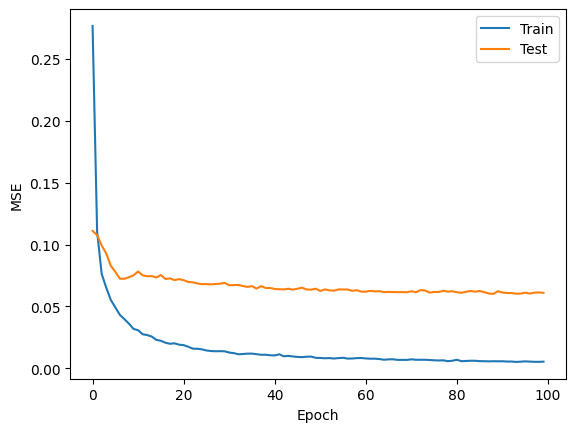

In [ ]:
plt.plot(history.history['mean_squared_error'])
plt.plot(history.history['val_mean_squared_error'])
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'])
plt.show()

На графике видно, что метрика на валидации не падает.

In [ ]:
mse_nn = min(history.history['val_mean_squared_error'])

In [ ]:
results.loc[len(results)] = ['NeuralNetwork', mse_nn]
results.sort_values('mse')

,model,mse
3,NeuralNetwork,0.060100
2,LGBMRegressor,0.063463
1,RandomForestRegressor,0.076291
0,LinearRegression,0.101654


**Вывод:**
- Разделили данные на обучающую и валидационную выборки
- Выбрали метрику для сравнения точности моделей - **MSE**
- Обучили c подбором гиперпараметров и сравнили несколько моделей - линейную регрессию, случайнй лес, градиентный бустинг и нейронные сети
- Лучший результат показала модель **NeuralNetwork**

## Тестирование модели

In [ ]:
test_images_path = '/content/drive/MyDrive/dsplus_integrated_project_4/to_upload/test_images'
image_filenames = [filename for filename in os.listdir(test_images_path) if filename.endswith('.jpg')]
test_image = pd.DataFrame(image_filenames, columns=['image'])
test_image.name = 'test_image'

In [ ]:
datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

def load_test():
    test_generator = datagen.flow_from_dataframe(
        dataframe = test_image,
        directory=test_images_path,
        x_col = 'image',
        y_col = None,
        target_size=(224, 224),
        class_mode='input',
        seed=RANDOM_STATE,
        shuffle=False)

    return test_generator

In [ ]:
# Получим эмбеддинги изображений тестового датасета
test_image_embeddings = vectorize_pictures(create_model(), load_test())

Found 100 validated image filenames.


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


4/4 ━━━━━━━━━━━━━━━━━━━━ 24s 5s/step


In [ ]:
test_image_norm = scaler_image.transform(test_image_embeddings)

In [ ]:
# создаем функцию сопоставления изображений с запросом
def get_picture(text) -> None:

    # проверяем, не нужно ли вывести на экран заглушку
    if [word for word in text.split() if word in STOP_WORDS]:
        print('')
        print('-' * 20, text, '-' * 20)
        print('')
        print('This image is unavailable in your country in compliance with local laws.')
        print('')
    else:

        test_text_embeddings = vectorize_text(text)
        text_embeddings_norm = scaler_text.transform(test_text_embeddings)

        X = np.concatenate(
            (test_image_norm, np.resize(text_embeddings_norm, (len(test_image_norm), 384))), axis=1)

        predictions = model_nn.predict(X)

        df = pd.concat((test_images,
                        pd.Series(np.reshape(predictions,
                         (predictions.shape[0],)), name='prediction')),
                       axis=1)
        top = list(df.sort_values(by='prediction',
                                    ascending=False)['image'].head(3))
        top_score = list(df.sort_values(by='prediction',
                                          ascending=False)['prediction'].head(3))

        print('')
        print('-' * 20, text, '-' * 20)
        print('')

        # выводим на экран 3 наиболее похожих изображений
        fig = plt.figure(figsize=(12,6))
        plt.rcParams['axes.edgecolor'] = 'black'
        plt.rcParams['axes.linewidth'] = 0
        for i in range(3):
            fig.add_subplot(1, 3, i+1, title=round(top_score[i], 2))
            image = Image.open(test_images_path+'/'+top[i])
            plt.imshow(image)
            plt.xticks([])
            plt.yticks([])
            plt.tight_layout()
        plt.show()

    return None


-------------------- A baby holds a game control above its head and laughs . --------------------

This image is unavailable in your country in compliance with local laws.



Batches:   0%|          | 0/1 [00:00<?, ?it/s]

1/4 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step

-------------------- The small fluffy white dog runs through the green grass with a tiny stick in its mouth . --------------------



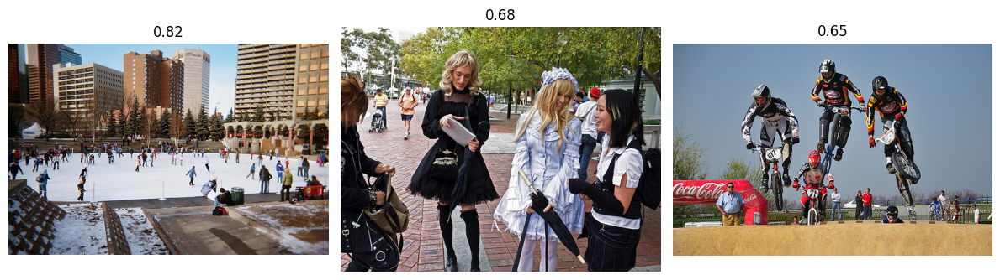

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step

-------------------- A man on an orange bike jumps in the air with the city line behind him . --------------------



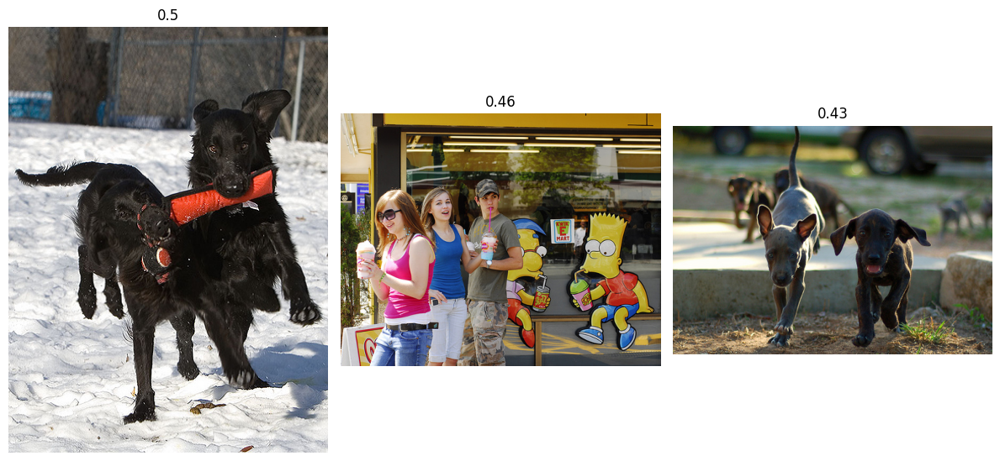


-------------------- The small baby in a yellow has the lower half of her body buried in sand . --------------------

This image is unavailable in your country in compliance with local laws.



Batches:   0%|          | 0/1 [00:00<?, ?it/s]

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step

-------------------- A man runs on a field with the ball and a man in a striped shirt is on the ground . --------------------



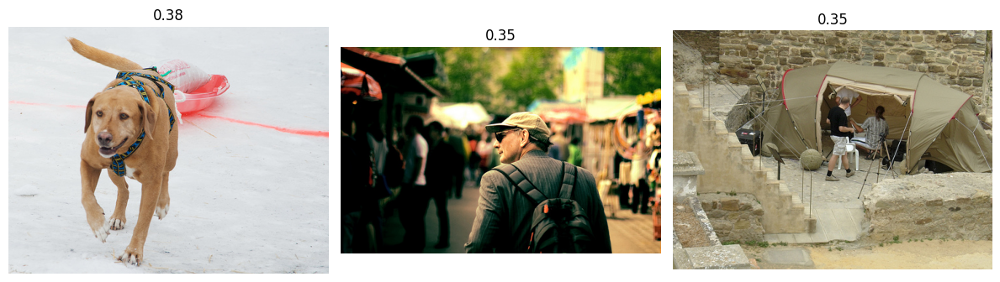


-------------------- An Afican American woman standing behind two small African American children . --------------------

This image is unavailable in your country in compliance with local laws.


-------------------- Two boys playing in water . --------------------

This image is unavailable in your country in compliance with local laws.



Batches:   0%|          | 0/1 [00:00<?, ?it/s]

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step

-------------------- A camera man is behind his video camera and surrounded by a hudge crowd . --------------------



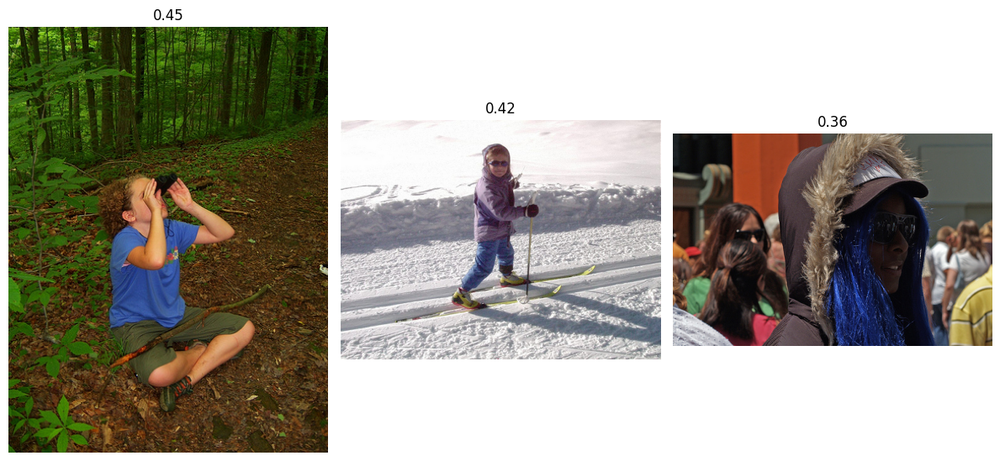


-------------------- Two boys spraying each other with water --------------------

This image is unavailable in your country in compliance with local laws.



Batches:   0%|          | 0/1 [00:00<?, ?it/s]

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step

-------------------- Two black dogs are playing with an orange stuffed dog toy . --------------------



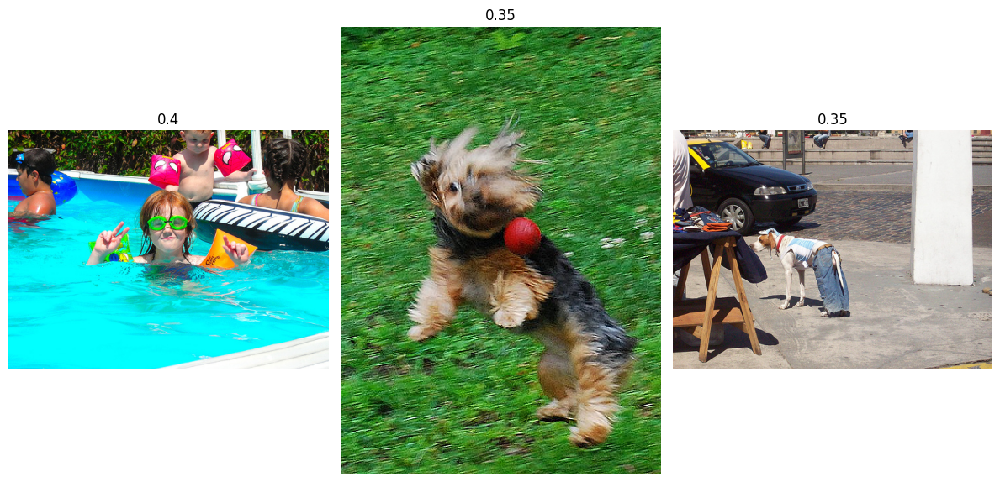


-------------------- Boys and girls at a party . --------------------

This image is unavailable in your country in compliance with local laws.



Batches:   0%|          | 0/1 [00:00<?, ?it/s]

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step

-------------------- The light colored dog is running through a field . --------------------



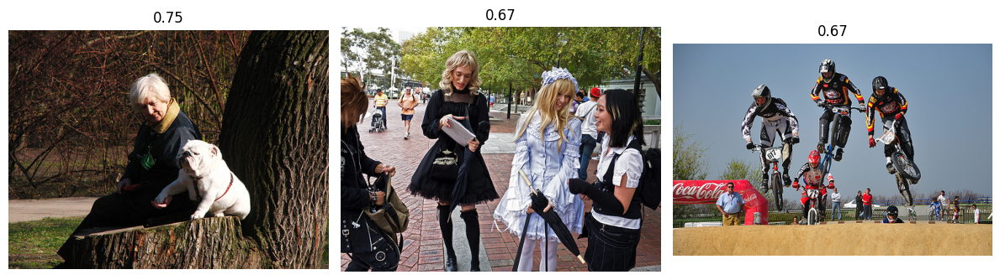

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step

-------------------- The woman lacrosse player in blue is about to catch the ball . --------------------



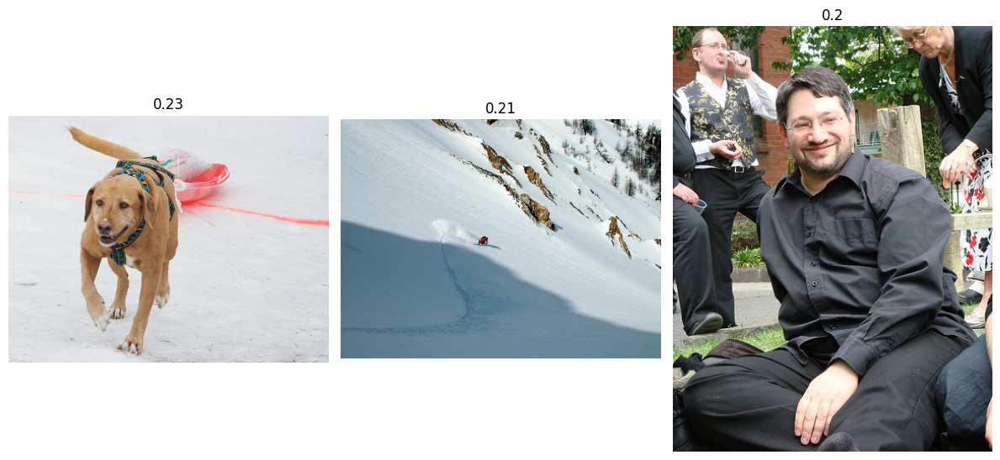


-------------------- A young boy is throwing something into a river . --------------------

This image is unavailable in your country in compliance with local laws.



Batches:   0%|          | 0/1 [00:00<?, ?it/s]

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step

-------------------- A group of six men stand in a circle playing instruments in a wooded parking lot . --------------------



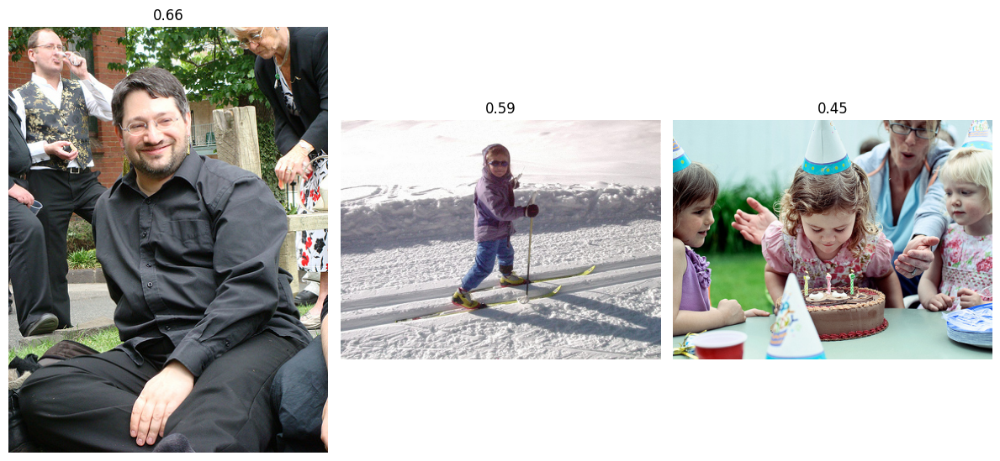

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step

-------------------- A sad looking dog sitting next to shrubs . --------------------



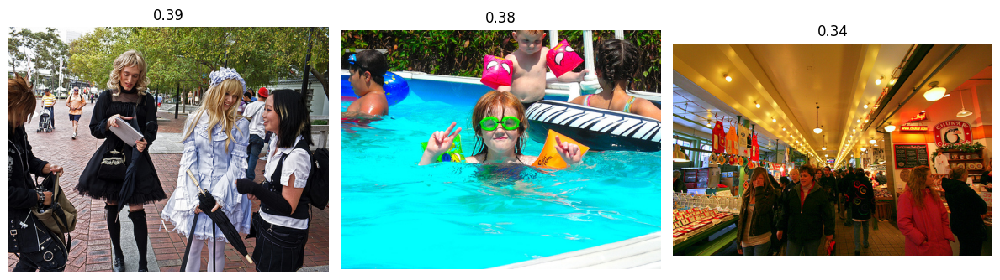


-------------------- A girl in a purple shirt feeding ducks --------------------

This image is unavailable in your country in compliance with local laws.


-------------------- A little girl with a hat sits between a woman 's feet in the sand in front of a pair of colorful tents . --------------------

This image is unavailable in your country in compliance with local laws.



Batches:   0%|          | 0/1 [00:00<?, ?it/s]

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step

-------------------- Two dogs play with each other outdoors . --------------------



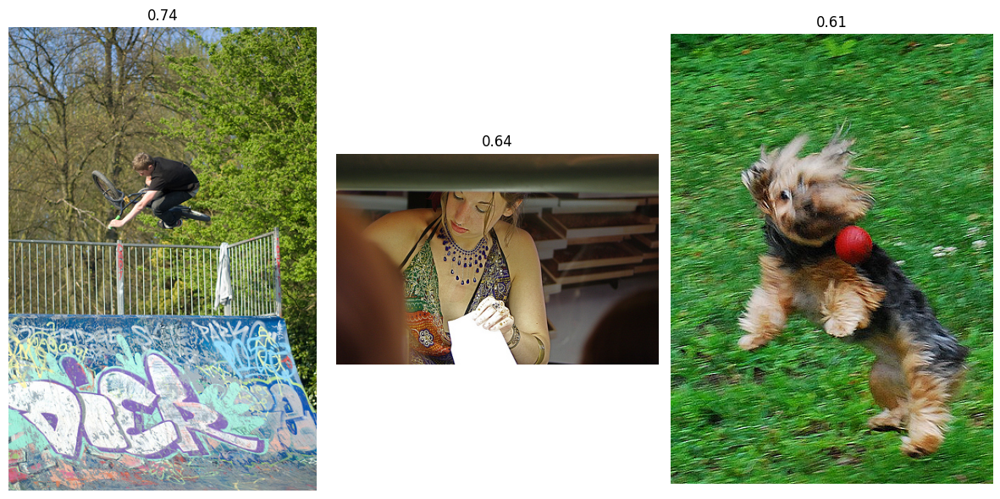

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step

-------------------- a kickboxer jumping for a kick --------------------



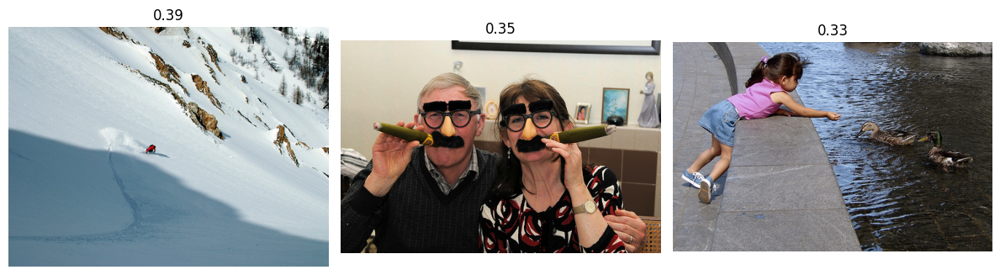

In [ ]:
# Выбираем 10 случайных фраз из тестовой выборки и выполняем инференс для каждой из них
test_phrases = test_queries['query_text'].sample(20)
for phrase in test_phrases:
    get_picture(phrase)

## Общий вывод

Мы видим, что наш прототип весьма посредственно справляется с поиском изображений по текстовому описанию, в некоторых случаях он верно указывает на собак. Из положительных моментов стоит отметить корректную работу с контентом, попадающим под юридические ограничения.

Причины видятся в следующем:

- недостаточный объем данных
- качество подготовки данных
- неудачно подобранные модели для обучения, возможно стоило попроборвать глубокие нейронные сети

Сбор и качественная подготовка данных, а так же обучение DNN занимает слишом много времени и ресурсов. Возможно в нашем случае стоит попробовать воспользоваться уже готовой моделью, специально подготовленной для таких задач.